In [ ]:
#!pip install PyTDC

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from upsetplot import UpSet, from_memberships

In [2]:
from tdc.multi_pred import DTI

data = DTI(name = 'DAVIS')
data_bindDB = DTI(name = 'BindingDB_Kd')
data_kiba = DTI(name = 'KIBA')

Found local copy...
Loading...
Done!
Found local copy...
Loading...
Done!
Found local copy...
Loading...
Done!


In [3]:
df_davis = data.get_data()

In [4]:
df_davis.groupby("Target_ID").count().sort_values("Drug_ID", ascending=False)

,Drug_ID,Drug,Target,Y
Target_ID,,,,
AAK1,68,68,68,68
PDGFRB,68,68,68,68
PIK3C2G,68,68,68,68
PIK3C2B,68,68,68,68
PHKG2,68,68,68,68
...,...,...,...,...
FGFR1,68,68,68,68
FES,68,68,68,68
FER,68,68,68,68


In [5]:
df_davis.Drug_ID.nunique()

68

Basically, Davis is a dataset of 68 drugs, 379 proteins. All tested against all.
We can not train models with this.

In [6]:
df_bindDB = data_bindDB.get_data()

In [7]:
df_bindDB.groupby("Target_ID").count().sort_values("Drug_ID", ascending=False).iloc[:20]

,Drug_ID,Drug,Target,Y
Target_ID,,,,
P00519,814,814,814,814
P10721,673,673,673,673
P36888,642,642,642,642
P15056,601,601,601,601
P00533,560,560,560,560
P51449,395,395,395,395
P00918,363,363,363,363
P24941,302,302,302,302
Q8K4Z4,229,229,229,229


In [8]:
df_kiba = data_kiba.get_data()

In [9]:
df_kiba.groupby("Target_ID").count().sort_values("Drug_ID", ascending=False).iloc[:20]

,Drug_ID,Drug,Target,Y
Target_ID,,,,
P35968,1432,1432,1432,1432
P17612,1237,1237,1237,1237
O94806,1203,1203,1203,1203
P49841,1168,1168,1168,1168
P06239,1135,1135,1135,1135
Q05655,1120,1120,1120,1120
P05129,1113,1113,1113,1113
P12931,1106,1106,1106,1106
P11309,1090,1090,1090,1090


In [10]:
set(df_kiba.Target_ID).intersection(set(df_bindDB))

set()

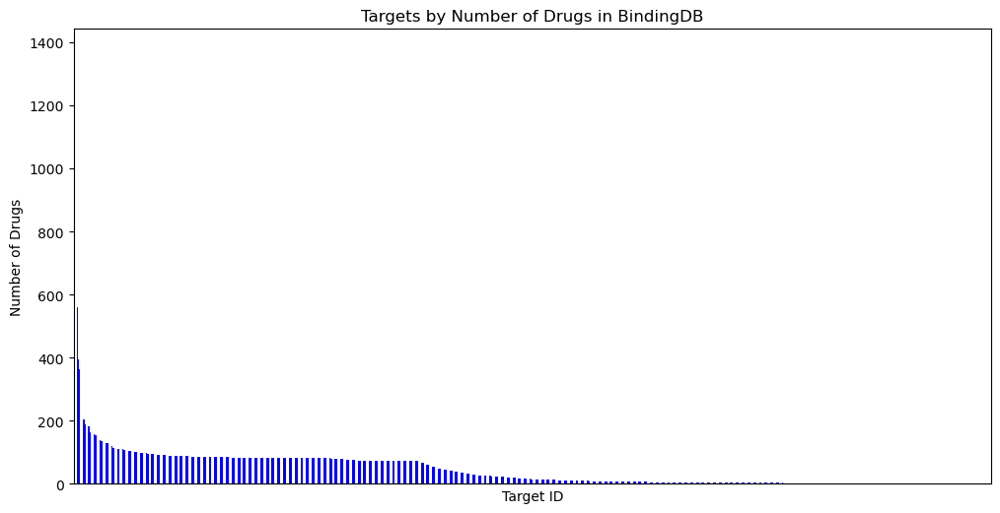

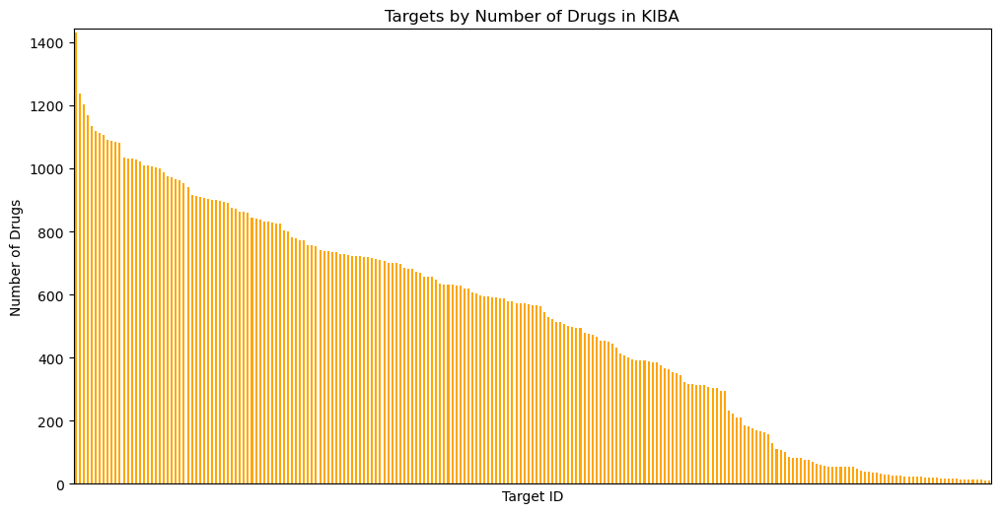

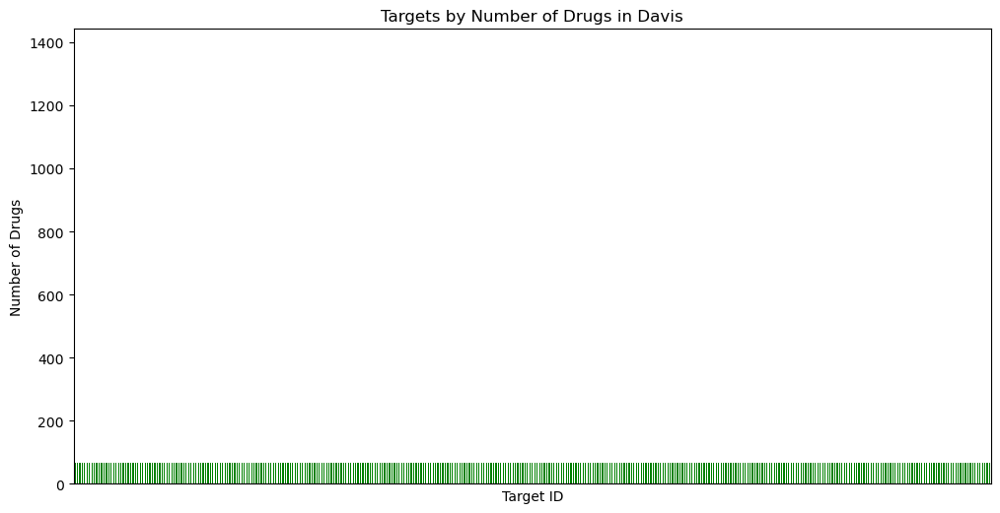

In [11]:

grouped_data_bindDB = df_bindDB.groupby("Target_ID").count().sort_values("Drug_ID", ascending=False)

grouped_data_kiba = df_kiba.groupby("Target_ID").count().sort_values("Drug_ID", ascending=False)

grouped_data_davis = df_davis.groupby("Target_ID").count().sort_values("Drug_ID", ascending=False)

def plot_grouped_data(grouped_data, title, color):
    plt.figure(figsize=(12, 6))
    grouped_data['Drug_ID'].plot(kind='bar', color=color)
    plt.title(title)
    plt.xlabel('Target ID')
    plt.ylabel('Number of Drugs')
    plt.ylim(0, max(grouped_data_bindDB['Drug_ID'].max(), grouped_data_kiba['Drug_ID'].max(), grouped_data_davis['Drug_ID'].max()) + 10)
    plt.xticks([])  # Remove x-axis labels
    plt.show()

# Plot the data for df_bindDB
plot_grouped_data(grouped_data_bindDB, 'Targets by Number of Drugs in BindingDB', 'blue')

# Plot the data for df_kiba
plot_grouped_data(grouped_data_kiba, 'Targets by Number of Drugs in KIBA', 'orange')

# Plot the data for df_davis
plot_grouped_data(grouped_data_davis, 'Targets by Number of Drugs in Davis', 'green')

In [13]:
grouped_data_kiba.iloc[:2]


,Drug_ID,Drug,Target,Y
Target_ID,,,,
P35968,1432,1432,1432,1432
P17612,1237,1237,1237,1237


In [183]:
# Create a dictionary series from df_kiba_subset where index is Target_ID and the value is a list of Drug_IDs
df_kiba_subset = df_kiba[['Target_ID','Drug_ID']].drop_duplicates()
targets_by_drug = df_kiba_subset.groupby('Drug_ID')['Target_ID'].apply(lambda x: list(set(x)))

In [184]:
drug_targets_membership = from_memberships(targets_by_drug)

In [185]:
drug_targets_membership

O00141  O00311  O00329  O00418  O00444  O14757  O14920  O14965  O15075  O15111  O15264  O15530  O43293  O43741  O43781  O60285  O60674  O75116  O75582  O75676  O94806  O95819  O96013  O96017  P00519  P00533  P04049  P04626  P04629  P05129  P05771  P06213  P06239  P06241  P06493  P07332  P07333  P07947  P07948  P07949  P08069  P08581  P08631  P08922  P09619  P09769  P10721  P11309  P11362  P11802  P12931  P15056  P15735  P16234  P16591  P17252  P17612  P17948  P19784  P21802  P22455  P22607  P22612  P22694  P23443  P23458  P24723  P24941  P27361  P27448  P28482  P29317  P29323  P29376  P29597  P30291  P30530  P31749  P31751  P34947  P35916  P35968  P36507  P36888  P41240  P41279  P41743  P42336  P42338  P42345  P42679  P42684  P42685  P43403  P43405  P45983  P45984  P48729  P48730  P48736  P49137  P49336  P49674  P49759  P49760  P49840  P49841  P50613  P50750  P51451  P51617  P51812  P51813  P51817  P51955  P51957  P52333  P52564  P53350  P53667  P53778  P53779  P54619  P54646  P54760  

In [190]:
UpSet(drug_targets_membership,subset_size="count",  max_subset_size=1)

In [16]:
#barplot of the number of targets per drug
plt.figure(figsize=(12, 6))
df_kiba_subset.groupby('Target_ID')['Drug_ID'].count().value_counts().sort_values(ascending=False).plot(kind='bar')
#make x-labels smaller
plt.xticks(fontsize=4)
plt.plot()

NameError: name 'df_kiba_subset' is not defined

<Figure size 1200x600 with 0 Axes>

[]

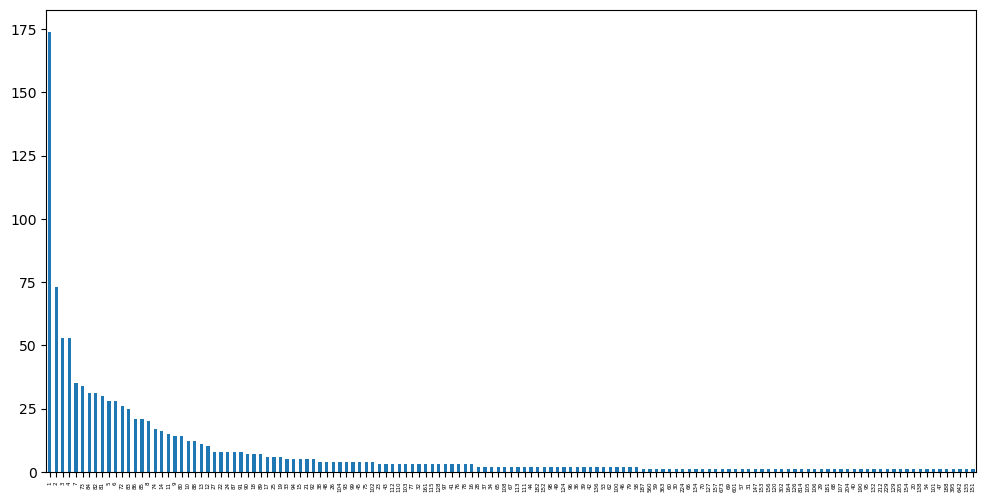

In [17]:
#barplot of the number of targets per drug
plt.figure(figsize=(12, 6))
df_bindDB.groupby('Target_ID')['Drug_ID'].count().value_counts().sort_values(ascending=False).plot(kind='bar')
#make x-labels smaller
plt.xticks(fontsize=4)
plt.plot()

In [78]:
df_bindDB.groupby('Drug_ID')['Target_ID'].count()

Drug_ID
51.0           4
187.0          3
237.0          1
242.0          3
243.0          0
              ..
138805907.0    1
138805908.0    1
138805909.0    1
138805910.0    1
138805911.0    1
Name: Target_ID, Length: 10636, dtype: int64

In [18]:
df_bindDB.groupby('Target_ID').count().sort_values(by="Drug_ID",ascending=False)

,Drug_ID,Drug,Target,Y
Target_ID,,,,
P00519,814,814,814,814
P10721,673,673,673,673
P36888,642,642,642,642
P15056,601,601,601,601
P00533,560,560,560,560
...,...,...,...,...
P17181,1,1,1,1
Q86V24,1,1,1,1
P16581,1,1,1,1


<AxesSubplot:>

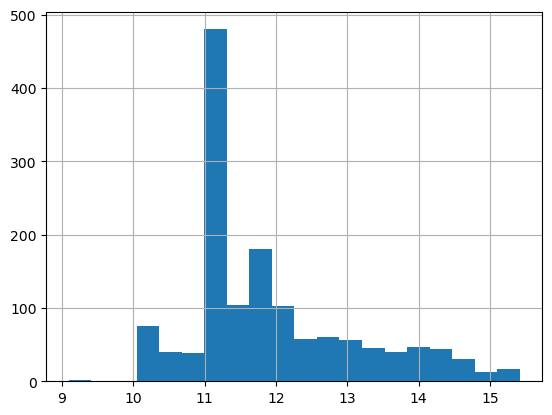

In [20]:
df_kiba.query("Target_ID == 'P35968'").Y.hist(bins=20)

<AxesSubplot:>

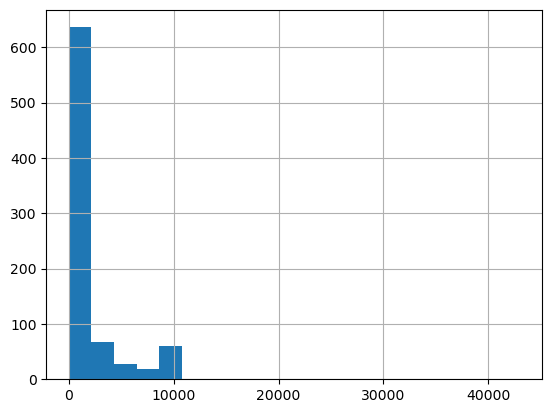

In [21]:
df_bindDB.query("Target_ID == 'P00519'").Y.hist(bins=20)

<AxesSubplot:>

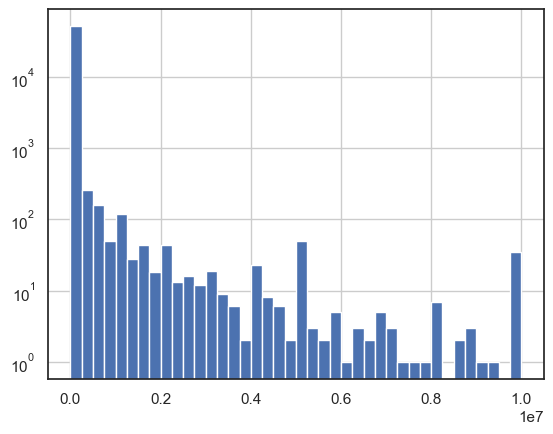

In [75]:
df_bindDB.Y.hist(log=True, bins=40)

<AxesSubplot:>

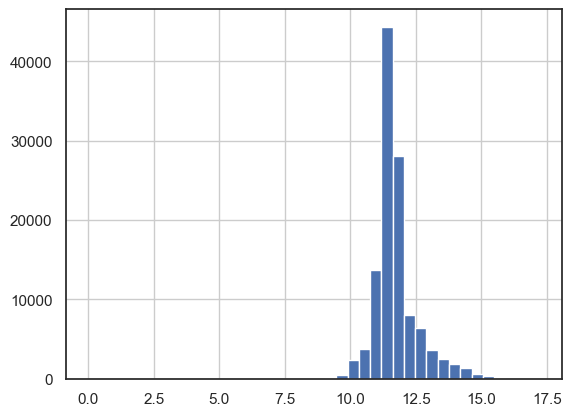

In [76]:
df_kiba.Y.hist(bins=40)

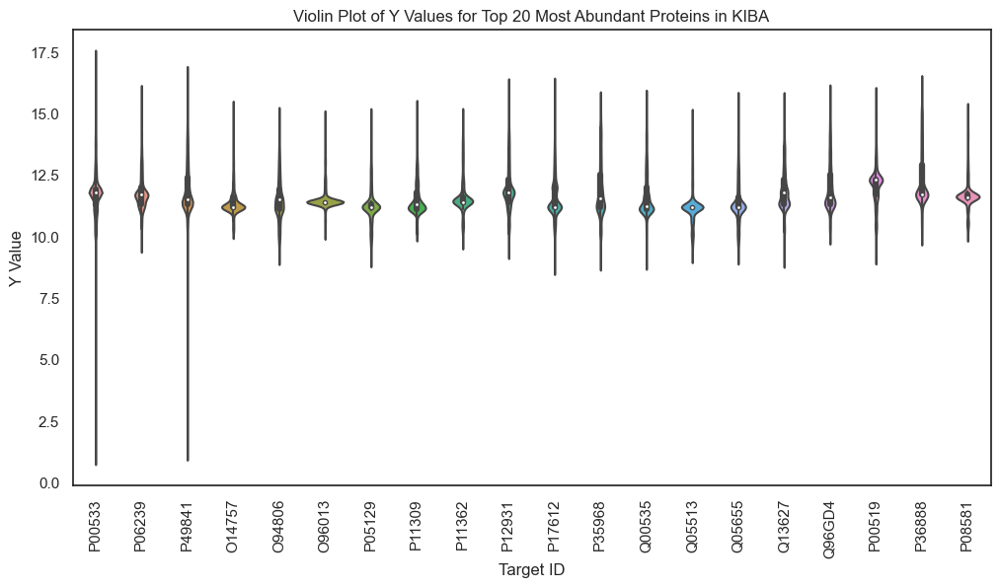

In [36]:
# Extract the top 20 most abundant proteins from grouped_data_kiba
top_20_proteins = grouped_data_kiba.nlargest(20, 'Drug_ID').index

# Filter df_kiba to include only the top 20 proteins
df_kiba_top_20 = df_kiba[df_kiba['Target_ID'].isin(top_20_proteins)]

# Plot violin plot for the Y values of the top 20 proteins
plt.figure(figsize=(12, 6))
sns.violinplot(x='Target_ID', y='Y', data=df_kiba_top_20,bw=0.2)
sns.rugplot(data=df_kiba_top_20, height=0.01, color='black')
plt.title('Violin Plot of Y Values for Top 20 Most Abundant Proteins in KIBA')
plt.xlabel('Target ID')
plt.ylabel('Y Value')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.show()

<Figure size 1200x800 with 0 Axes>

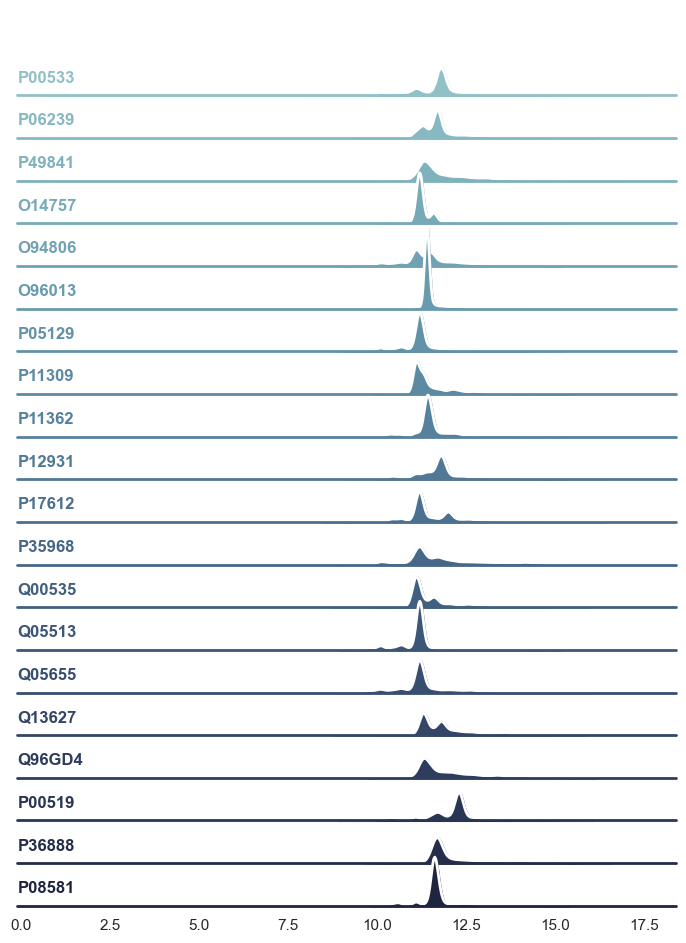

In [43]:
# Extract the top 20 most abundant proteins from grouped_data_kiba
def plot_ridge(df, grouped_data, top_n=20):
    sns.set(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

    # Extract the top N most abundant proteins from grouped_data
    top_proteins = grouped_data.nlargest(top_n, 'Drug_ID').index

    # Filter df to include only the top N proteins
    df_top_proteins = df[df['Target_ID'].isin(top_proteins)]

    # Create a ridge plot for the Y values of the top N proteins
    plt.figure(figsize=(12, 8))
    sns.set(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

    # Create a color palette with N colors
    palette = sns.cubehelix_palette(top_n, rot=-.25, light=.7)

    # Initialize the FacetGrid object
    g = sns.FacetGrid(df_top_proteins, row="Target_ID", hue="Target_ID", aspect=15, height=0.5, palette=palette)

    # Draw the densities in a few steps
    g.map(sns.kdeplot, "Y", clip_on=False, shade=True, alpha=1, lw=1.5, bw_adjust=.5)
    g.map(sns.kdeplot, "Y", clip_on=False, color="w", lw=2, bw_adjust=.5)
    g.map(plt.axhline, y=0, lw=2, clip_on=False)

    # Define and use a simple function to label the plots in axes coordinates
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label, fontweight="bold", color=color, ha="left", va="center", transform=ax.transAxes)

    g.map(label, "Y")

    # Set the subplots to overlap
    g.fig.subplots_adjust(hspace=-0.5)

    # Remove axes details that don't play well with overlap
    g.set_titles("")
    g.set(yticks=[])
    g.despine(bottom=True, left=True)
    g.set_axis_labels("", "")

    plt.show()

# Example usage for df_kiba
plot_ridge(df_kiba, grouped_data_kiba, top_n=20)
#sns.set(style="", rc={"axes.facecolor": (0, 0, 0, 0)})


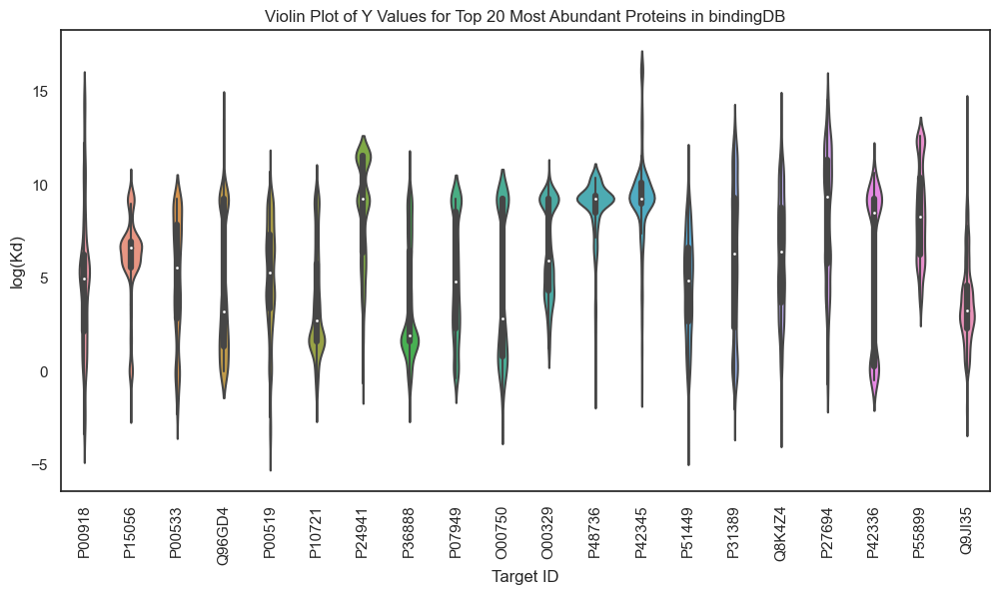

In [60]:
# Extract the top 20 most abundant proteins from grouped_data_bindDB
top_20_proteins = grouped_data_bindDB.nlargest(20, 'Drug_ID').index

df_bindDB_top_20 = df_bindDB[df_bindDB['Target_ID'].isin(top_20_proteins)]
df_bindDB_top_20["Y_log"] = np.log(df_bindDB_top_20["Y"])

# Plot violin plot for the Y values of the top 20 proteins
plt.figure(figsize=(12, 6))
sns.violinplot(x='Target_ID', y='Y_log', data=df_bindDB_top_20,bw=0.2)
plt.title('Violin Plot of Y Values for Top 20 Most Abundant Proteins in bindingDB')
plt.xlabel('Target ID')
plt.ylabel('log(Kd)')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.show()